<a href="https://colab.research.google.com/github/MichelleAppel/distribution-aware-image-to-image-translation/blob/master/toy_examples/Fly_AE_animated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### imports



In [1]:
import os.path
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import make_grid
import torchvision.transforms as transforms

from itertools import chain

import numpy as np
import math
import itertools
import random

from scipy import signal

import matplotlib.pyplot as plt

import zipfile

import os
import pickle

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

import numpy as np
import os
import copy
from PIL import Image, ImageDraw, ImageFont

!pip install webcolors
from webcolors import hex_to_rgb

# Fly data experiment

## The Fly dataset

In [2]:
zipdataroot_A = '/content/drive/MyDrive/fly_data_ubc_2021/generated_fly_with_annotation.zip'
zipdataroot_B = '/content/drive/MyDrive/fly_data_ubc_2021/real_fly.zip'

dataroot_A = '/content/flydata/data_A'
dataroot_B = '/content/flydata/data_B'

if not os.path.exists(dataroot_A):
  with zipfile.ZipFile(zipdataroot_A, 'r') as zip_ref:
      zip_ref.extractall(dataroot_A)

if not os.path.exists(dataroot_B):
  with zipfile.ZipFile(zipdataroot_B, 'r') as zip_ref:
      zip_ref.extractall(dataroot_B)

In [3]:
IMG_EXTENSIONS = [
    '.jpg', '.JPG', '.jpeg', '.JPEG',
    '.png', '.PNG', '.ppm', '.PPM', '.bmp', '.BMP',
]

def is_image_file(filename):
    return any(filename.endswith(extension) for extension in IMG_EXTENSIONS)

def make_dataset(dir):
    images = []
    assert os.path.isdir(dir), '%s is not a valid directory' % dir

    for root, _, fnames in sorted(os.walk(dir)):
        for fname in fnames:
            if is_image_file(fname) and not fname.endswith('real_A.png') and not fname.endswith('render_pose.png'):
                path = os.path.join(root, fname)
                images.append(path)

    return images

In [4]:
def __adjust(img):
    ow, oh = img.size

    # the size needs to be a multiple of this number,
    # because going through generator network may change img size
    # and eventually cause size mismatch error
    mult = 4
    if ow % mult == 0 and oh % mult == 0:
        return img
    w = (ow - 1) // mult
    w = (w + 1) * mult
    h = (oh - 1) // mult
    h = (h + 1) * mult

    return img.resize((w, h), Image.BICUBIC)

def normalize(img):
  return img * 2 - 1


def get_transform():
    loadSize = 128
    osize = [loadSize, loadSize]

    transform_list = []
    transform_list.append(transforms.Lambda(
            lambda img: __adjust(img)))
    
    transform_list.append(transforms.Resize(osize, Image.BICUBIC))  
    transform_list += [transforms.ToTensor()]
                      #  transforms.Normalize((0.5, 0.5, 0.5),
                      #                       (0.5, 0.5, 0.5))]
    transform_list.append(transforms.Lambda(
            lambda img: normalize(img)))
    
    return transforms.Compose(transform_list)

In [5]:
class FlyDataset(Dataset):
  def __init__(self, annotations=False):
    self.dataroot_A = '/content/flydata/data_A'

    self.annotations = annotations
    if self.annotations:
      self.dataroot_B = '/content/flydata/data_B/real_fly_with_annotations'
      self.path_anno_A = '/content/flydata/data_A/test_14_14/target_anno.pth'
      self.path_anno_B = '/content/flydata/data_B/real_fly_with_annotations/test_anno.pth'
      self.anno_A = pickle.load(open(self.path_anno_A,'rb'))
      self.anno_B = pickle.load(open(self.path_anno_B,'rb'))
    else:
      self.dataroot_B = '/content/flydata/data_B/real_fly_without_annotations'

    self.A_paths = make_dataset(self.dataroot_A)
    self.B_paths = make_dataset(self.dataroot_B)

    self.A_size = len(self.A_paths)
    self.B_size = len(self.B_paths)

    self.dir_len = len(self.dataroot_A) + 1

    self.transform = get_transform()

  def __getitem__(self, index):
      A_path = self.A_paths[index % self.A_size]
      A_name = A_path[self.dir_len:]
      
      index_B = random.randint(0, self.B_size - 1)
      B_path = self.B_paths[index_B]

      A_img = Image.open(A_path).convert('RGB')
      B_img = Image.open(B_path).convert('RGB')

      A = self.transform(A_img)
      B = self.transform(B_img)

      if self.annotations:
        A_anno = torch.Tensor(self.anno_A[A_path.split('/')[-1]])
        B_anno = torch.Tensor(self.anno_B[B_path.split('/')[-1]])
        return {'A': A, 'B': B, 'A_anno': A_anno, 'B_anno': B_anno}
      else:
        return {'A': A, 'B': B}

  def __len__(self):
    return max(self.A_size, self.B_size)

In [6]:
dataset = FlyDataset()

batch_size = 32
dataloader = DataLoader(dataset, batch_size, shuffle=True)

In [7]:
def visualize(img):
  plt.imshow((img.permute(1,2,0) + 1) / 2)
  plt.show()

## The AE network

We use a VAE to encode the latent space of the fly images.

In [8]:
# VAE code from https://github.com/podgorskiy/VAE

class AE(nn.Module):
    def __init__(self, zsize, layer_count=5, channels=3):
        super(AE, self).__init__()

        d = 128
        self.d = d
        self.zsize = zsize

        self.layer_count = layer_count

        mul = 1
        inputs = channels
        for i in range(self.layer_count):
            setattr(self, "conv%d" % (i + 1), nn.Conv2d(inputs, d * mul, 4, 2, 1))
            setattr(self, "conv%d_bn" % (i + 1), nn.BatchNorm2d(d * mul))
            inputs = d * mul
            mul *= 2

        self.d_max = inputs

        self.fc1 = nn.Linear(inputs * 4 * 4, zsize)

        self.d1 = nn.Linear(zsize, inputs * 4 * 4)

        mul = inputs // d // 2

        for i in range(1, self.layer_count):
            setattr(self, "deconv%d" % (i + 1), nn.ConvTranspose2d(inputs, d * mul, 4, 2, 1))
            setattr(self, "deconv%d_bn" % (i + 1), nn.BatchNorm2d(d * mul))
            inputs = d * mul
            mul //= 2

        setattr(self, "deconv%d" % (self.layer_count + 1), nn.ConvTranspose2d(inputs, channels, 4, 2, 1))

    def encode(self, x):
        for i in range(self.layer_count):
            x = F.relu(getattr(self, "conv%d_bn" % (i + 1))(getattr(self, "conv%d" % (i + 1))(x)))

        x = x.view(x.shape[0], self.d_max * 4 * 4)
        h = self.fc1(x)
        return h

    def decode(self, x):
        x = x.view(x.shape[0], self.zsize)
        x = self.d1(x)
        x = x.view(x.shape[0], self.d_max, 4, 4)
        #x = self.deconv1_bn(x)
        x = F.leaky_relu(x, 0.2)

        for i in range(1, self.layer_count):
            x = F.leaky_relu(getattr(self, "deconv%d_bn" % (i + 1))(getattr(self, "deconv%d" % (i + 1))(x)), 0.2)

        x = F.tanh(getattr(self, "deconv%d" % (self.layer_count + 1))(x))
        return x

    def forward(self, x):
        z = self.encode(x)
        return self.decode(z.view(-1, self.zsize, 1, 1)), z

    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

def normal_init(m, mean, std):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        m.weight.data.normal_(mean, std)
        m.bias.data.zero_()

## Training the AE

We first train the AE first to establish translation to the latent space.

In [11]:
def loss_function(recon_x, x):
    BCE = torch.mean((recon_x - x)**2)

    # see Appendix B from VAE paper:
    # Kingma and Welling. Auto-Encoding Variational Bayes. ICLR, 2014
    # https://arxiv.org/abs/1312.6114
    # 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
    # KLD = -0.5 * torch.mean(torch.mean(1 + logvar - mu.pow(2) - logvar.exp(), 1))
    return BCE #, KLD * 0.1

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1628: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


epoch 0 step 0 loss_re_AB 1.0356330871582031


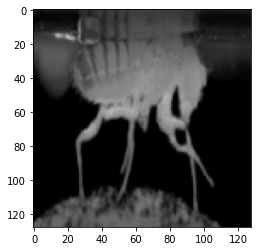

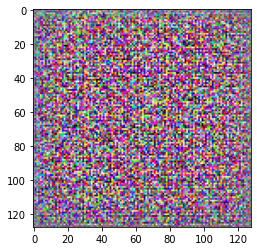

epoch 0 step 10 loss_re_AB 0.15369045734405518
epoch 0 step 20 loss_re_AB 0.09262572973966599
epoch 0 step 30 loss_re_AB 0.06976018100976944
epoch 0 step 40 loss_re_AB 0.05517510697245598
epoch 1 step 0 loss_re_AB 0.051443591713905334


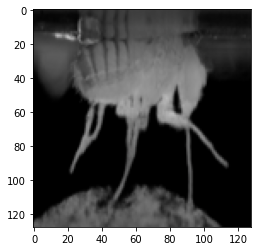

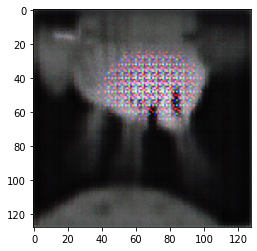

epoch 1 step 10 loss_re_AB 0.047180574387311935
epoch 1 step 20 loss_re_AB 0.04094409942626953
epoch 1 step 30 loss_re_AB 0.03831157833337784
epoch 1 step 40 loss_re_AB 0.03597330302000046
epoch 2 step 0 loss_re_AB 0.034455396234989166


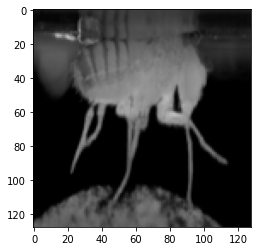

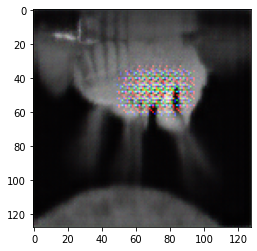

epoch 2 step 10 loss_re_AB 0.03455767035484314
epoch 2 step 20 loss_re_AB 0.03212852403521538
epoch 2 step 30 loss_re_AB 0.032000377774238586
epoch 2 step 40 loss_re_AB 0.02970932424068451
epoch 3 step 0 loss_re_AB 0.03022395633161068


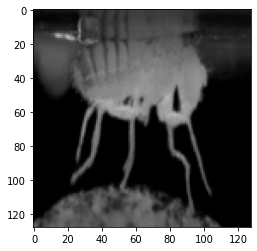

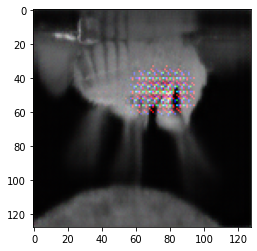

epoch 3 step 10 loss_re_AB 0.029246285557746887
epoch 3 step 20 loss_re_AB 0.02909684181213379
epoch 3 step 30 loss_re_AB 0.02881164848804474
epoch 3 step 40 loss_re_AB 0.029116202145814896
epoch 4 step 0 loss_re_AB 0.027321431785821915


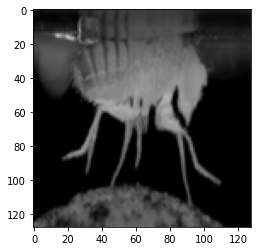

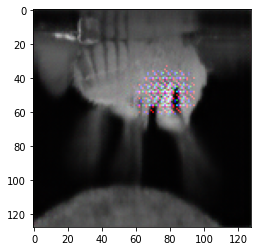

epoch 4 step 10 loss_re_AB 0.027211468666791916
epoch 4 step 20 loss_re_AB 0.0273771733045578
epoch 4 step 30 loss_re_AB 0.026441119611263275
epoch 4 step 40 loss_re_AB 0.024524910375475883
epoch 5 step 0 loss_re_AB 0.02485021948814392


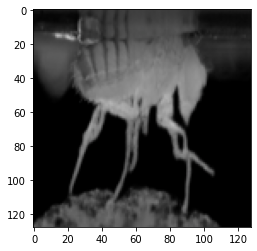

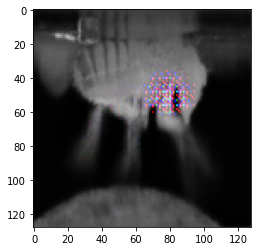

epoch 5 step 10 loss_re_AB 0.024205302819609642
epoch 5 step 20 loss_re_AB 0.024197425693273544
epoch 5 step 30 loss_re_AB 0.023669322952628136
epoch 5 step 40 loss_re_AB 0.024775436148047447
epoch 6 step 0 loss_re_AB 0.0214982982724905


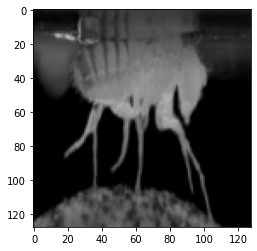

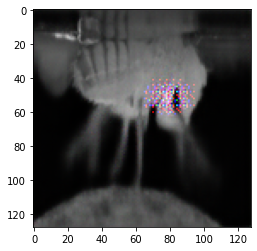

epoch 6 step 10 loss_re_AB 0.022855957970023155
epoch 6 step 20 loss_re_AB 0.022433321923017502
epoch 6 step 30 loss_re_AB 0.019764941185712814
epoch 6 step 40 loss_re_AB 0.020847897976636887
learning rate change!
epoch 7 step 0 loss_re_AB 0.020623719319701195


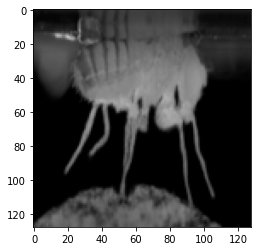

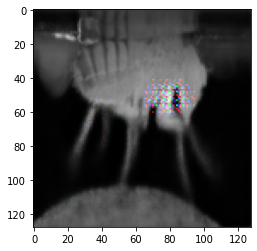

epoch 7 step 10 loss_re_AB 0.01938503608107567
epoch 7 step 20 loss_re_AB 0.018796714022755623
epoch 7 step 30 loss_re_AB 0.01877550408244133
epoch 7 step 40 loss_re_AB 0.017965426668524742
epoch 8 step 0 loss_re_AB 0.018025530502200127


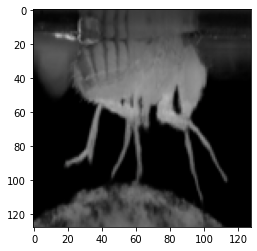

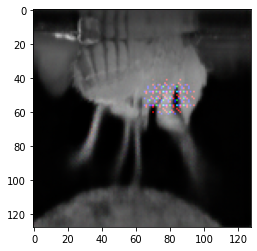

epoch 8 step 10 loss_re_AB 0.019131585955619812
epoch 8 step 20 loss_re_AB 0.01741877943277359
epoch 8 step 30 loss_re_AB 0.01795654557645321
epoch 8 step 40 loss_re_AB 0.016537293791770935
epoch 9 step 0 loss_re_AB 0.01721613109111786


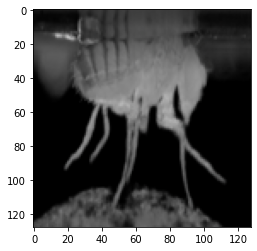

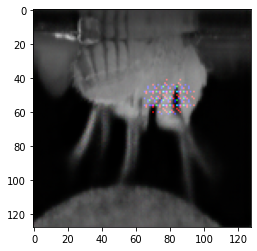

epoch 9 step 10 loss_re_AB 0.017642691731452942
epoch 9 step 20 loss_re_AB 0.016422688961029053
epoch 9 step 30 loss_re_AB 0.016163082793354988
epoch 9 step 40 loss_re_AB 0.0163662638515234
epoch 10 step 0 loss_re_AB 0.015622640028595924


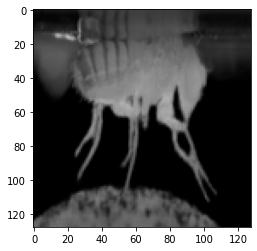

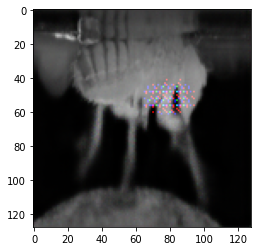

epoch 10 step 10 loss_re_AB 0.015711437910795212
epoch 10 step 20 loss_re_AB 0.015033107250928879
epoch 10 step 30 loss_re_AB 0.015288489870727062
epoch 10 step 40 loss_re_AB 0.014641771093010902
epoch 11 step 0 loss_re_AB 0.014329354278743267


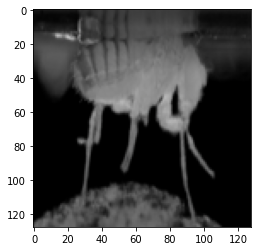

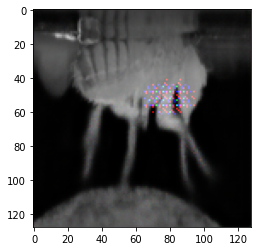

epoch 11 step 10 loss_re_AB 0.014566134661436081
epoch 11 step 20 loss_re_AB 0.013945292681455612
epoch 11 step 30 loss_re_AB 0.014575603418052197
epoch 11 step 40 loss_re_AB 0.01298755593597889
epoch 12 step 0 loss_re_AB 0.012958778068423271


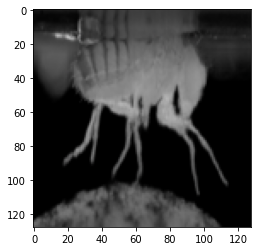

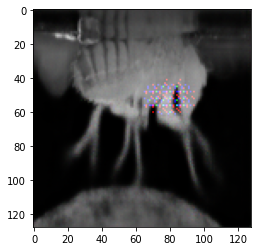

epoch 12 step 10 loss_re_AB 0.012901733629405499
epoch 12 step 20 loss_re_AB 0.012800060212612152
epoch 12 step 30 loss_re_AB 0.012615961953997612
epoch 12 step 40 loss_re_AB 0.012987340800464153
epoch 13 step 0 loss_re_AB 0.012306246906518936


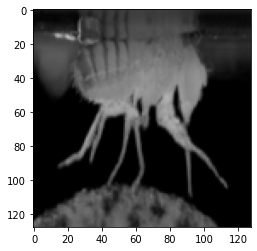

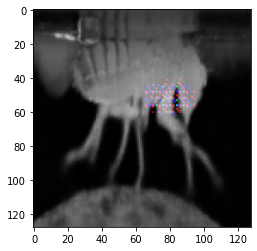

epoch 13 step 10 loss_re_AB 0.012534054927527905
epoch 13 step 20 loss_re_AB 0.011960245668888092
epoch 13 step 30 loss_re_AB 0.011621463112533092
epoch 13 step 40 loss_re_AB 0.011460292153060436
epoch 14 step 0 loss_re_AB 0.011711588129401207


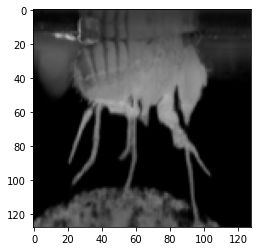

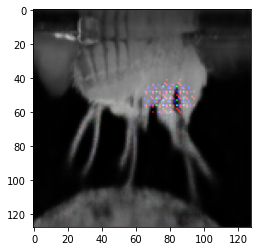

epoch 14 step 10 loss_re_AB 0.011504883877933025
epoch 14 step 20 loss_re_AB 0.01086965948343277
epoch 14 step 30 loss_re_AB 0.011214569211006165
epoch 14 step 40 loss_re_AB 0.011096096597611904
learning rate change!
epoch 15 step 0 loss_re_AB 0.010240796953439713


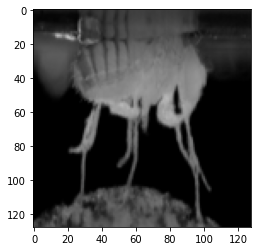

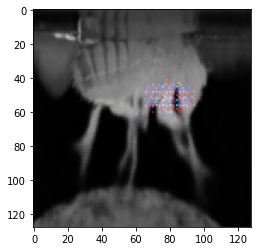

epoch 15 step 10 loss_re_AB 0.009479792788624763
epoch 15 step 20 loss_re_AB 0.009648731909692287
epoch 15 step 30 loss_re_AB 0.009361129254102707
epoch 15 step 40 loss_re_AB 0.009575587697327137
epoch 16 step 0 loss_re_AB 0.009519446641206741


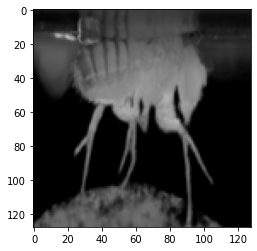

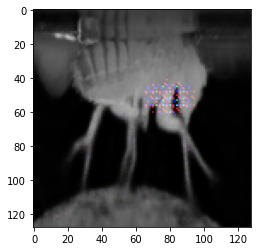

epoch 16 step 10 loss_re_AB 0.009501179680228233
epoch 16 step 20 loss_re_AB 0.009192680940032005
epoch 16 step 30 loss_re_AB 0.008992418646812439
epoch 16 step 40 loss_re_AB 0.009218785911798477
epoch 17 step 0 loss_re_AB 0.009003845043480396


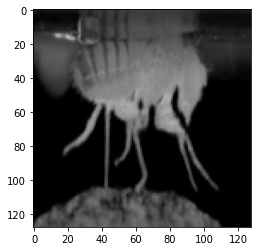

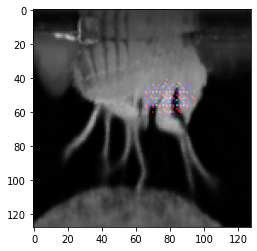

epoch 17 step 10 loss_re_AB 0.00892786867916584
epoch 17 step 20 loss_re_AB 0.009231267496943474
epoch 17 step 30 loss_re_AB 0.008769242092967033
epoch 17 step 40 loss_re_AB 0.008913137018680573
epoch 18 step 0 loss_re_AB 0.008709961548447609


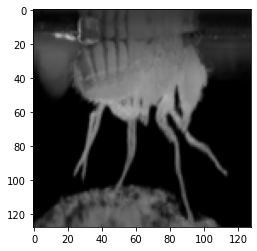

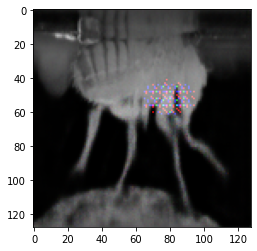

epoch 18 step 10 loss_re_AB 0.008863616734743118
epoch 18 step 20 loss_re_AB 0.008676255121827126
epoch 18 step 30 loss_re_AB 0.008723558858036995
epoch 18 step 40 loss_re_AB 0.008714021183550358
epoch 19 step 0 loss_re_AB 0.00846552848815918


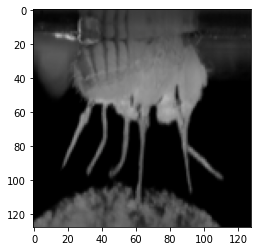

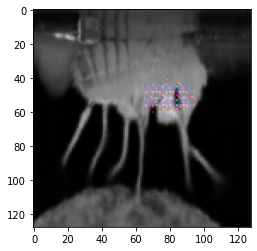

epoch 19 step 10 loss_re_AB 0.008272814564406872
epoch 19 step 20 loss_re_AB 0.008579186163842678
epoch 19 step 30 loss_re_AB 0.008484063670039177
epoch 19 step 40 loss_re_AB 0.008202726021409035
epoch 20 step 0 loss_re_AB 0.008296450600028038


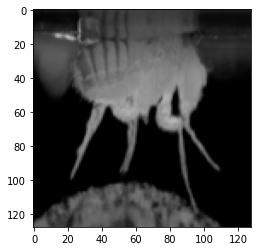

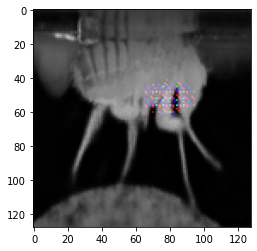

epoch 20 step 10 loss_re_AB 0.008221618831157684
epoch 20 step 20 loss_re_AB 0.008483131416141987
epoch 20 step 30 loss_re_AB 0.008239914663136005
epoch 20 step 40 loss_re_AB 0.008188614621758461
epoch 21 step 0 loss_re_AB 0.008151012472808361


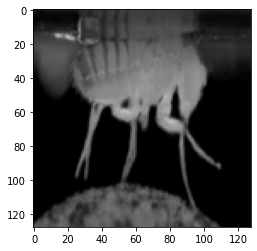

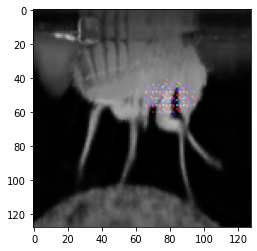

epoch 21 step 10 loss_re_AB 0.007899436168372631
epoch 21 step 20 loss_re_AB 0.008216200396418571
epoch 21 step 30 loss_re_AB 0.008273269049823284
epoch 21 step 40 loss_re_AB 0.007922220043838024
epoch 22 step 0 loss_re_AB 0.0076304106041789055


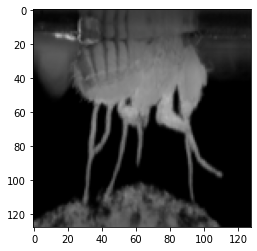

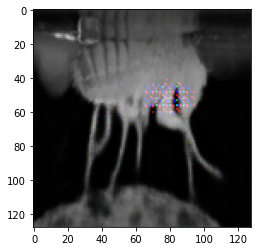

epoch 22 step 10 loss_re_AB 0.007758141960948706
epoch 22 step 20 loss_re_AB 0.007679250091314316
epoch 22 step 30 loss_re_AB 0.007849205285310745
epoch 22 step 40 loss_re_AB 0.00788122694939375
learning rate change!
epoch 23 step 0 loss_re_AB 0.007553033530712128


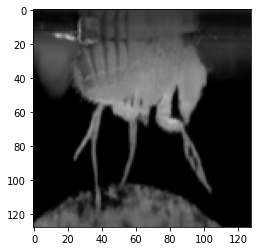

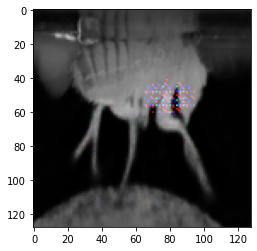

epoch 23 step 10 loss_re_AB 0.0075096068903803825
epoch 23 step 20 loss_re_AB 0.007464650087058544
epoch 23 step 30 loss_re_AB 0.007617343217134476
epoch 23 step 40 loss_re_AB 0.007382752373814583
epoch 24 step 0 loss_re_AB 0.007259398698806763


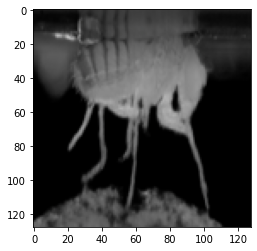

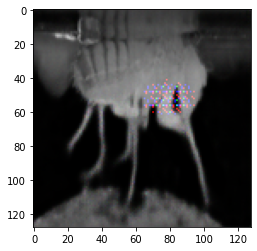

epoch 24 step 10 loss_re_AB 0.007300152443349361
epoch 24 step 20 loss_re_AB 0.007330168038606644
epoch 24 step 30 loss_re_AB 0.007340656127780676
epoch 24 step 40 loss_re_AB 0.007476180791854858
epoch 25 step 0 loss_re_AB 0.007230463437736034


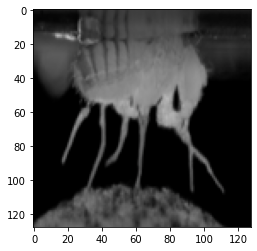

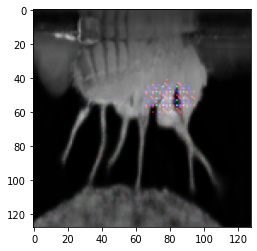

epoch 25 step 10 loss_re_AB 0.007348721846938133
epoch 25 step 20 loss_re_AB 0.007236486300826073
epoch 25 step 30 loss_re_AB 0.007224732544273138
epoch 25 step 40 loss_re_AB 0.0072664907202124596
epoch 26 step 0 loss_re_AB 0.007098349742591381


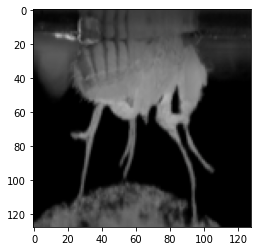

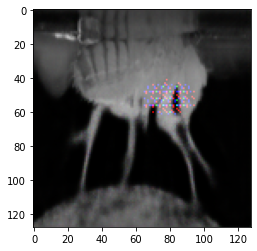

epoch 26 step 10 loss_re_AB 0.00710101705044508
epoch 26 step 20 loss_re_AB 0.007253517862409353
epoch 26 step 30 loss_re_AB 0.007377152796834707
epoch 26 step 40 loss_re_AB 0.006972356699407101
epoch 27 step 0 loss_re_AB 0.006883062422275543


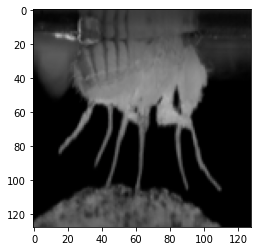

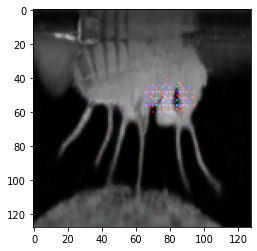

epoch 27 step 10 loss_re_AB 0.007102916017174721
epoch 27 step 20 loss_re_AB 0.007069865241646767
epoch 27 step 30 loss_re_AB 0.007016717456281185
epoch 27 step 40 loss_re_AB 0.006887946277856827
epoch 28 step 0 loss_re_AB 0.007031738758087158


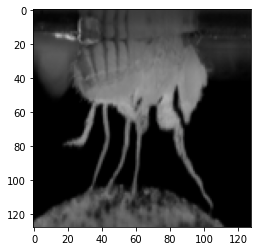

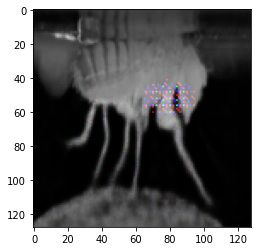

epoch 28 step 10 loss_re_AB 0.0070436070673167706
epoch 28 step 20 loss_re_AB 0.007169445510953665
epoch 28 step 30 loss_re_AB 0.007217752747237682
epoch 28 step 40 loss_re_AB 0.007092950865626335
epoch 29 step 0 loss_re_AB 0.0069837188348174095


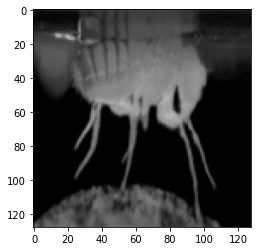

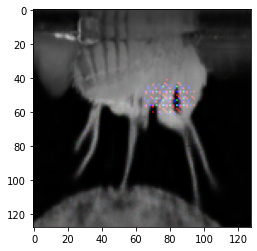

epoch 29 step 10 loss_re_AB 0.00686604855582118
epoch 29 step 20 loss_re_AB 0.006915352772921324
epoch 29 step 30 loss_re_AB 0.007102718111127615
epoch 29 step 40 loss_re_AB 0.006901394575834274
epoch 30 step 0 loss_re_AB 0.006932697258889675


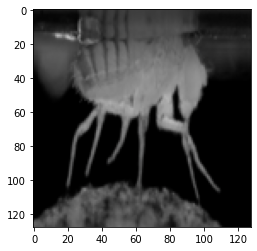

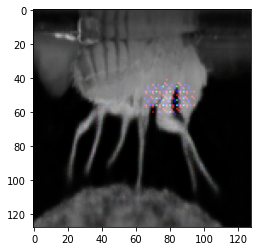

epoch 30 step 10 loss_re_AB 0.00692636426538229
epoch 30 step 20 loss_re_AB 0.006838025059551001
epoch 30 step 30 loss_re_AB 0.006761112716048956
epoch 30 step 40 loss_re_AB 0.007076272740960121
learning rate change!
epoch 31 step 0 loss_re_AB 0.006777862086892128


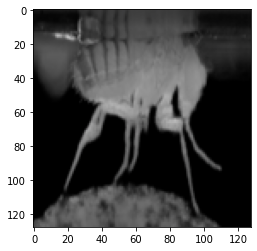

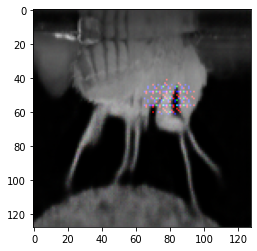

epoch 31 step 10 loss_re_AB 0.006795781664550304
epoch 31 step 20 loss_re_AB 0.006811845116317272
epoch 31 step 30 loss_re_AB 0.0067469398491084576
epoch 31 step 40 loss_re_AB 0.00683459360152483
epoch 32 step 0 loss_re_AB 0.0067396340891718864


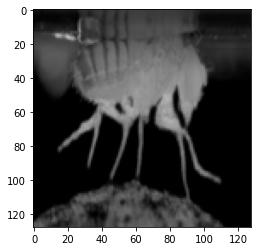

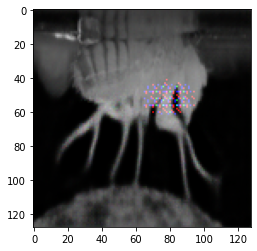

epoch 32 step 10 loss_re_AB 0.006793588399887085
epoch 32 step 20 loss_re_AB 0.006889994256198406
epoch 32 step 30 loss_re_AB 0.00679390411823988
epoch 32 step 40 loss_re_AB 0.006839836947619915
epoch 33 step 0 loss_re_AB 0.0065360600128769875


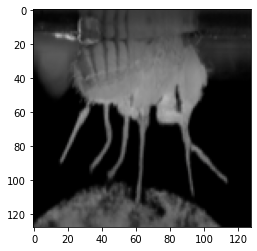

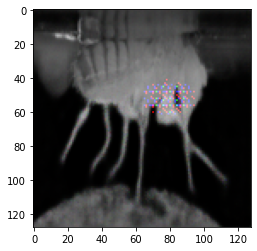

epoch 33 step 10 loss_re_AB 0.006818635389208794
epoch 33 step 20 loss_re_AB 0.0068434434942901134
epoch 33 step 30 loss_re_AB 0.006617306731641293
epoch 33 step 40 loss_re_AB 0.0068809473887085915
epoch 34 step 0 loss_re_AB 0.006798881106078625


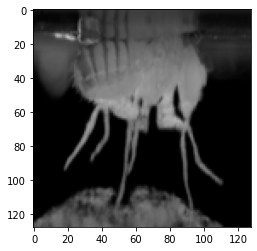

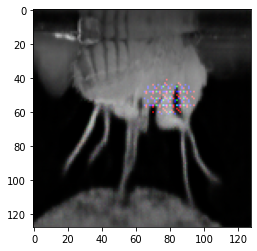

epoch 34 step 10 loss_re_AB 0.006818500813096762
epoch 34 step 20 loss_re_AB 0.006687648594379425
epoch 34 step 30 loss_re_AB 0.006812830455601215
epoch 34 step 40 loss_re_AB 0.0068374574184417725
epoch 35 step 0 loss_re_AB 0.006802007555961609


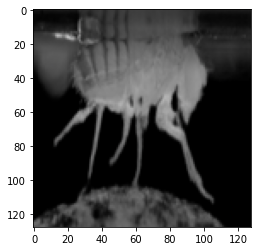

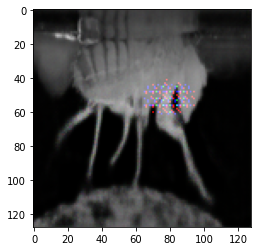

epoch 35 step 10 loss_re_AB 0.006833679974079132
epoch 35 step 20 loss_re_AB 0.006780707743018866
epoch 35 step 30 loss_re_AB 0.006896441336721182
epoch 35 step 40 loss_re_AB 0.006689762230962515
epoch 36 step 0 loss_re_AB 0.006708289962261915


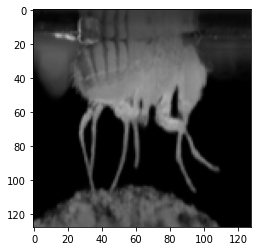

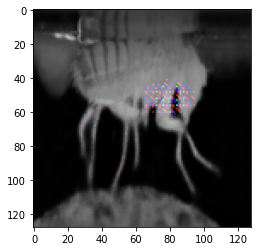

epoch 36 step 10 loss_re_AB 0.006673291325569153
epoch 36 step 20 loss_re_AB 0.006736195646226406
epoch 36 step 30 loss_re_AB 0.006698927842080593
epoch 36 step 40 loss_re_AB 0.006627844180911779
epoch 37 step 0 loss_re_AB 0.006812141742557287


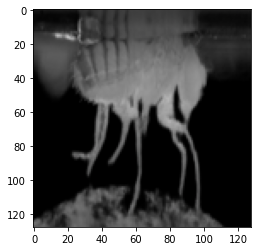

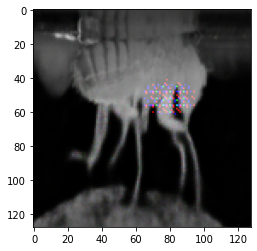

epoch 37 step 10 loss_re_AB 0.006689634174108505
epoch 37 step 20 loss_re_AB 0.006734995171427727
epoch 37 step 30 loss_re_AB 0.0067759668454527855
epoch 37 step 40 loss_re_AB 0.006806635297834873
epoch 38 step 0 loss_re_AB 0.0066350726410746574


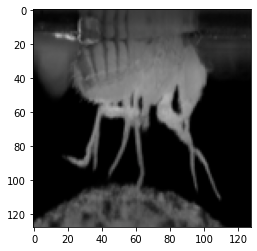

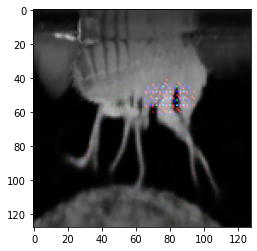

epoch 38 step 10 loss_re_AB 0.006730941589921713
epoch 38 step 20 loss_re_AB 0.0066568441689014435
epoch 38 step 30 loss_re_AB 0.006654947996139526
epoch 38 step 40 loss_re_AB 0.006660710088908672
learning rate change!
epoch 39 step 0 loss_re_AB 0.006828985642641783


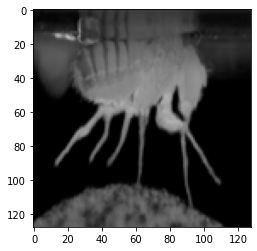

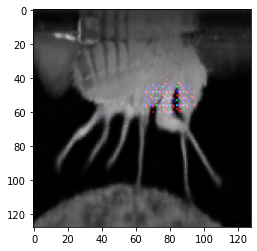

epoch 39 step 10 loss_re_AB 0.006545897573232651
epoch 39 step 20 loss_re_AB 0.006720633711665869
epoch 39 step 30 loss_re_AB 0.006670339964330196
epoch 39 step 40 loss_re_AB 0.006630381103605032


In [12]:
# Initialize the network
ae = AE(zsize=32).cuda()

# Initialize the optimizers
lr = 0.0005
ae_optimizer = optim.Adam(ae.parameters(), lr=lr, betas=(0.5, 0.999), weight_decay=1e-5)
train_epoch = 40

# For storing results
rec_loss_AB = []

for epoch in range(train_epoch):
    ae.train() # Training mode

    if (epoch + 1) % 8 == 0: # Adaptive learning rate
        ae_optimizer.param_groups[0]['lr'] /= 4
        print("learning rate change!")

    for i, data in enumerate(dataloader):
        ae.zero_grad()
        
        img_A = data['A'].cuda()
        img_B = data['B'].cuda()
        img_AB = img_A#torch.cat((img_A, img_B))

        # The embeddings
        rec_AB, z_AB = ae(img_AB)

        # The loss function --------------------------------------------------------------------------------
        loss_re_AB = loss_function(rec_AB, img_AB)

        # Backward -----------------------------------------------------------------------------------------
        (loss_re_AB).backward()
        ae_optimizer.step()

        # Store values -------------------------------------------------------------------------------------
        rec_loss_AB += [loss_re_AB.item()]

        # --------------------------------------------------------------------------------------------------
        # Print statistics
        if i % 10 == 0:
            print('epoch', epoch, 'step', i,
                  'loss_re_AB', loss_re_AB.item())

        if i % 50 == 0: # Visualize output now and then
            visualize(img_AB[0].cpu())
            visualize(rec_AB[0].detach().cpu())

## Results of the VAE training

In [13]:
def smooth(list):
  return signal.savgol_filter(list, 101, 3)

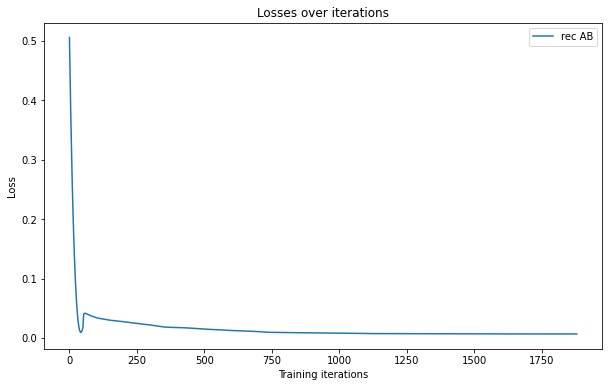

In [15]:
plt.figure(figsize=(10,6))
plt.title('Losses over iterations')
plt.xlabel('Training iterations')
plt.ylabel('Loss')
plt.plot(smooth(rec_loss_AB))
# plt.plot(smooth(kl_loss_AB))
plt.legend(['rec AB', 'kl AB'])
plt.show()

## Save/Load AE model

In [12]:
# torch.save(ae.state_dict(), '/content/drive/MyDrive/ae_A')

In [11]:
# # Load model
ae = AE(zsize=32).cuda()
ae.load_state_dict(torch.load('/content/drive/MyDrive/ae_A'))
ae.eval()

AE(
  (conv1): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv1_bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(1024, 2048, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv5_bn): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=32768, out_features=32, bias=True)
  (d1): Linear(in_features=32, out_features=32768, bias=True

## VAE latent space analyzation

Training of the VAE takes a while. This way you can load a saved model.

We are about to visualize the latent representation of the entire dataset. Since the GPU space is limited, the dataset is loaded and fed to the network in batches.

In [17]:
batch_size = 32
dataloader_all = DataLoader(dataset, batch_size, shuffle=True)

recs_AB = ()
zs_AB = ()

for i, data in enumerate(dataloader_all):
  data_AB = torch.cat((data['A'], data['B']))
  rec_AB, z_AB = ae(data_AB.cuda())
  recs_AB += (rec_AB.detach().cpu(), )
  zs_AB += (z_AB.detach().cpu(), )

recs_AB = torch.cat(recs_AB)
zs_AB = torch.cat(zs_AB)

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1628: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


In [18]:
def visualize_grid(img):
  plt.figure(figsize=(15,15))
  plt.imshow((img.permute(1,2,0) + 1) / 2)
  plt.axis('off')
  plt.show()

First, lets take a look at the produced reconstructions. The AE seems to translate encode the poses well, even with a small latent space of size 32.

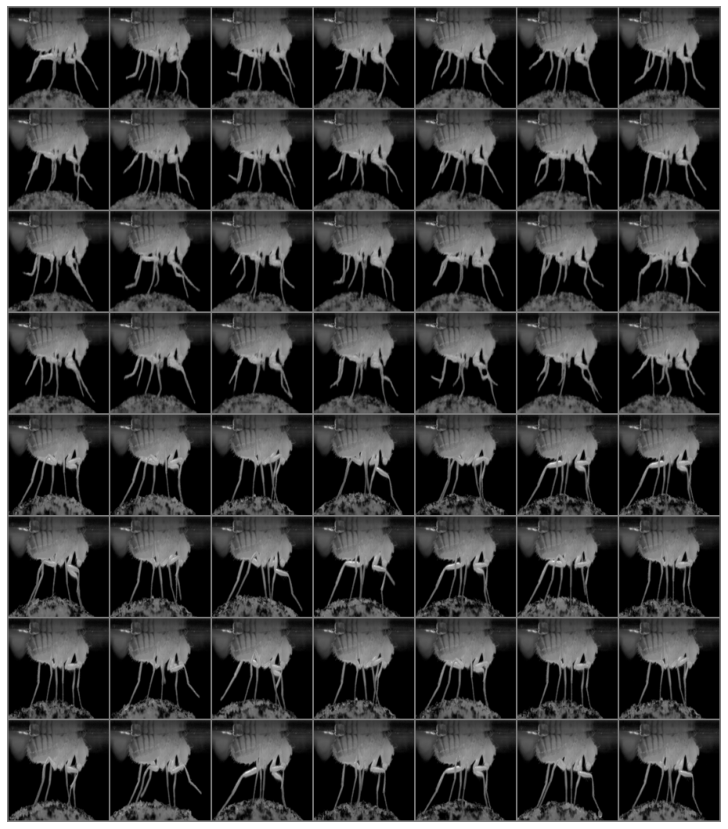

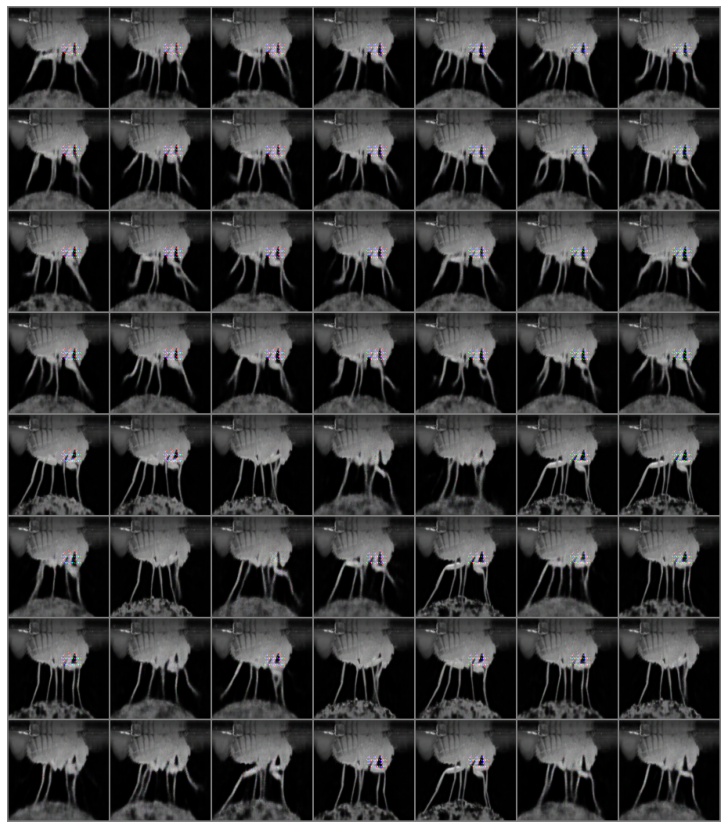

In [17]:
visualize_grid(make_grid(data_AB, nrow=7))
visualize_grid(make_grid(rec_AB.detach().cpu(), nrow=7))

In [19]:
# Perform t-SNE embedding
embedded_z = TSNE(n_components=2).fit_transform(zs_AB.detach().cpu())

In [20]:
# Get the right labels
idx = torch.zeros(3000, dtype=torch.uint8)
for i in range(93):
  if i % 2 == 0:
    idx[32*i:32*(i+1)] = 1
  
idx_A = idx==1
idx_B = idx==0

Even though the reconstructed images look not that different from one another, we can see a difference in the latent space representation between real and fake images. This means that distribution net should be able to learn the difference in distribtion of the domains.

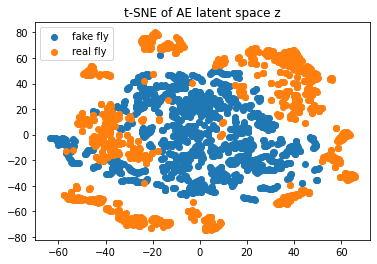

In [21]:
plt.title('t-SNE of AE latent space z')
plt.scatter(embedded_z[idx_A, 0], embedded_z[idx_A, 1])
plt.scatter(embedded_z[idx_B, 0], embedded_z[idx_B, 1])
plt.legend(['fake fly', 'real fly'])
plt.show()


In [22]:
pca = PCA(n_components=2)
pca_z = pca.fit_transform(zs_AB)

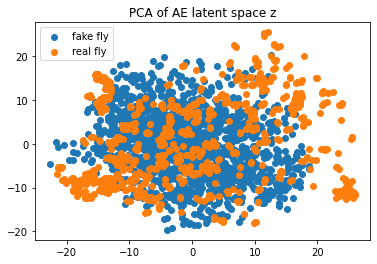

In [23]:
plt.title('PCA of AE latent space z')
plt.scatter(pca_z[idx_A, 0], pca_z[idx_A, 1])
plt.scatter(pca_z[idx_B, 0], pca_z[idx_B, 1])
plt.legend(['fake fly', 'real fly'])
plt.show()

## Annotation analyzation

In [24]:
dataset = FlyDataset(annotations=True)

all_anno_A = torch.Tensor(list(dataset.anno_A.values()))[:, :15].view(-1,30)
all_anno_B = torch.Tensor(list(dataset.anno_B.values())).view(-1,30)

In [51]:
def draw_skeleton(img, keypoints, width = 1 , r = 1):
    color = ['#A64AC9','#FCCD04','#FFB48F','F5E6CC','17E9E0','86C232' ]
    im = copy.deepcopy(img)
    d = ImageDraw.Draw(im)
    num_legs = int(len(keypoints)/5)
    for i in range(num_legs):
        x = keypoints[np.arange(0+i*5,(i+1)*5,1).tolist(),1]
        y = keypoints[np.arange(0+i*5,(i+1)*5,1).tolist(),0]
        d.line(list(zip(y,x)), fill = hex_to_rgb(color[i]),width= width)
        for j in range(5):
            d.ellipse((y[j]-r, x[j]-r, y[j]+r, x[j]+r), fill = 'red', outline ='red')
    return im

In [26]:
batch_size = 1
dataloader = DataLoader(dataset, batch_size, shuffle=True)

for dataexample in dataloader:
  img_A = dataexample['A']
  img_B = dataexample['B']

  anno_A = dataexample['A_anno'][:, :15]
  anno_B = dataexample['B_anno']

  break

fake fly


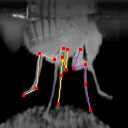

In [27]:
print('fake fly')
draw_skeleton(transforms.ToPILImage()((img_A[0] + 1) / 2).convert("RGB"), anno_A[0]*128)

real fly


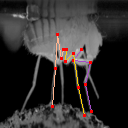

In [28]:
print('real fly')
draw_skeleton(transforms.ToPILImage()((img_B[0] + 1) / 2).convert("RGB"), anno_B[0]*128)

In [29]:
pca = PCA(n_components=2)
# pca.fit(torch.cat((all_anno_A, all_anno_B)).view(-1,30))
pca.fit(all_anno_A)
# pca.fit(all_anno_B)
pca_anno = pca.transform(torch.cat((all_anno_A, all_anno_B)).view(-1,30))

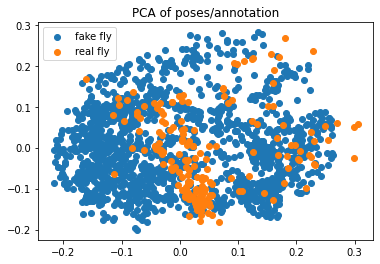

In [30]:
plt.title('PCA of poses/annotation')
plt.scatter(pca_anno[:len(all_anno_A), 0], pca_anno[:len(all_anno_A), 1])
plt.scatter(pca_anno[len(all_anno_A):, 0], pca_anno[len(all_anno_A):, 1])
plt.legend(['fake fly', 'real fly'])
plt.show()

In [31]:
def n_centered_moment(x, w, n):
  if n > 1:
    c = n_centered_moment(x, w, 1)
  else:
    c = 0
  return (((x - c)**n)*w).sum(0)

In [32]:
mean_anno_A = n_centered_moment(anno_A, 1/len(anno_A), 1)
mean_anno_B = n_centered_moment(anno_A, 1/len(anno_B), 1)
var_anno_A = n_centered_moment(anno_A, 1/len(anno_A), 2)
var_anno_B = n_centered_moment(anno_A, 1/len(anno_B), 2)

In [33]:
mse = nn.MSELoss()

In [34]:
mse(mean_anno_A, mean_anno_B), mse(var_anno_A, var_anno_B)

(tensor(0.), tensor(0.))

## Distribution network

In [13]:
class DistributionNet(nn.Module):
    '''A simple network that predicts the importances of the samples'''

    def __init__(self):
        super(DistributionNet, self).__init__()
        self.softmax = nn.Softmax(dim=0)

        self.conv1 = nn.Conv2d(3, 10, kernel_size=7)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.conv3 = nn.Conv2d(20, 40, kernel_size=5)
        self.fc1 = nn.Linear(40*12*12, 40)
        self.fc2 = nn.Linear(40, 1)
        
    def forward(self, x):
        h1 = torch.sigmoid(F.max_pool2d(self.conv1(x), 2))
        h2 = torch.sigmoid(F.max_pool2d(self.conv2(h1), 2))
        h3 = torch.sigmoid(F.max_pool2d(self.conv3(h2), 2))
        h4 = h3.view(-1, 40*12*12)
        h5 = torch.sigmoid(self.fc1(h4))
        out = self.fc2(h5)
        return self.softmax(out), out

## Training of distribution net

The goal of this network is to predict the relative frequency of samples.

In [36]:
dataset = FlyDataset(annotations=True)

batch_size = 32
dataloader = DataLoader(dataset, batch_size, shuffle=True)

In [38]:
# Initialize the networks
distribution_network = DistributionNet().cuda()
# Initialize the optimizers
lr = 0.001
optimizer_d = optim.Adam(distribution_network.parameters(), lr=lr)

criterion_d = nn.MSELoss()
mse = nn.MSELoss()

# For storing results
losses_d = []

means_A = []
means_B = []

vars_A = []
vars_B = []

moments_A = []
moments_B = []

anno_means_A = []
anno_means_B = []
anno_vars_A = []
anno_vars_B = []
anno_mse_means = []
anno_mse_vars = []

n = 1 # n-centered moment
ae.eval()

for epoch in range(40):
    for i, data in enumerate(dataloader):
        
        img_A = data['A'].cuda()
        img_B = data['B'].cuda()

        anno_A = data['A_anno'][:, :15].cuda()
        anno_B = data['B_anno'].cuda()

        # The embeddings
        rec_A, z_A = ae(img_A)
        rec_B, z_B = ae(img_B)

        # The weighting process
        w_A = distribution_network(img_A)[0]
        w_B = 1/len(img_B)

        # The loss function --------------------------------------------------------------------------------
        n_centered_moment_A = n_centered_moment(z_A.detach(), w_A, n)
        n_centered_moment_B = n_centered_moment(z_B.detach(), w_B, n)
        loss_d = criterion_d(n_centered_moment_A, n_centered_moment_B)

        mean_anno_A = n_centered_moment(anno_A.view(-1, 30), w_A, 1)
        mean_anno_B = n_centered_moment(anno_B.view(-1, 30), w_B, 1)
        var_anno_A = n_centered_moment(anno_A.view(-1, 30), w_A, 2)
        var_anno_B = n_centered_moment(anno_B.view(-1, 30), w_B, 2)
        mse_mean_anno = mse(mean_anno_A, mean_anno_B)
        mse_var_anno = mse(var_anno_A, var_anno_B)

        # ---------------------------------------------------------------------------------------------------

        # Backward
        optimizer_d.zero_grad()
        loss_d.backward()
        optimizer_d.step() 

        # Store values --------------------------------------------------------------------------------------
        moments_A += [n_centered_moment_A.cpu().detach().numpy()]
        moments_B += [n_centered_moment_B.cpu().detach().numpy()]

        means_A += [n_centered_moment(z_A, w_A, 1).detach().cpu().numpy()]
        means_B += [n_centered_moment(z_B, w_B, 1).detach().cpu().numpy()]

        vars_A += [n_centered_moment(z_A, w_A, 2).detach().cpu().numpy()]
        vars_B += [n_centered_moment(z_B, w_B, 2).detach().cpu().numpy()]

        anno_means_A += [mean_anno_A.detach().cpu().numpy()]
        anno_means_B += [mean_anno_B.detach().cpu().numpy()]
        anno_vars_A += [var_anno_A.detach().cpu().numpy()]
        anno_vars_B += [var_anno_B.detach().cpu().numpy()]

        anno_mse_means += [mse_mean_anno.item()]
        anno_mse_vars += [mse_var_anno.item()]

        losses_d += [loss_d.item()]

        # ---------------------------------------------------------------------------------------------------

        # Print statistics
        if i % 10 == 0:
            print('epoch', epoch, 'step', i, 'loss_d: ', loss_d.item())
            
        if i % 10000 == 0 and i != 0:
            break

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1628: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


epoch 0 step 0 loss_d:  6.6643781661987305
epoch 0 step 10 loss_d:  7.301560401916504
epoch 0 step 20 loss_d:  11.083391189575195
epoch 0 step 30 loss_d:  6.5639448165893555
epoch 0 step 40 loss_d:  5.5356903076171875
epoch 1 step 0 loss_d:  5.970754623413086
epoch 1 step 10 loss_d:  3.965682029724121
epoch 1 step 20 loss_d:  5.662046432495117
epoch 1 step 30 loss_d:  3.676321029663086
epoch 1 step 40 loss_d:  6.97995662689209
epoch 2 step 0 loss_d:  3.62133526802063
epoch 2 step 10 loss_d:  3.9092352390289307
epoch 2 step 20 loss_d:  3.982978343963623
epoch 2 step 30 loss_d:  4.973889350891113
epoch 2 step 40 loss_d:  4.350253582000732
epoch 3 step 0 loss_d:  7.009737491607666
epoch 3 step 10 loss_d:  4.852556228637695
epoch 3 step 20 loss_d:  4.321252822875977
epoch 3 step 30 loss_d:  4.229186058044434
epoch 3 step 40 loss_d:  5.9633636474609375
epoch 4 step 0 loss_d:  4.009332180023193
epoch 4 step 10 loss_d:  4.115420341491699
epoch 4 step 20 loss_d:  4.900479316711426
epoch 4 step

KeyboardInterrupt: ignored

In [39]:
moments_A = torch.Tensor(moments_A)
moments_B = torch.Tensor(moments_B)
means_A = torch.Tensor(means_A)
means_B = torch.Tensor(means_B)
vars_A = torch.Tensor(vars_A)
vars_B = torch.Tensor(vars_B)

anno_means_A = torch.Tensor(anno_means_A)
anno_means_B = torch.Tensor(anno_means_B)
anno_vars_A = torch.Tensor(anno_vars_A)
anno_vars_B = torch.Tensor(anno_vars_B)
anno_mse_means = torch.Tensor(anno_mse_means)
anno_mse_vars = torch.Tensor(anno_mse_vars)

## Results of distribution net

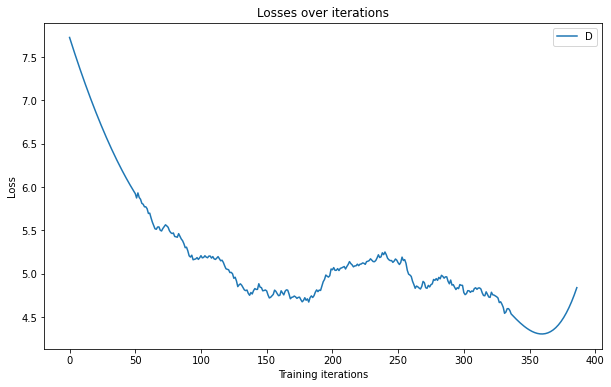

In [41]:
plt.figure(figsize=(10,6))
plt.title('Losses over iterations')
plt.xlabel('Training iterations')
plt.ylabel('Loss')
smoothed_losses_d = signal.savgol_filter(losses_d,101,3)
plt.plot(smoothed_losses_d)
plt.legend(['D'])
plt.show()

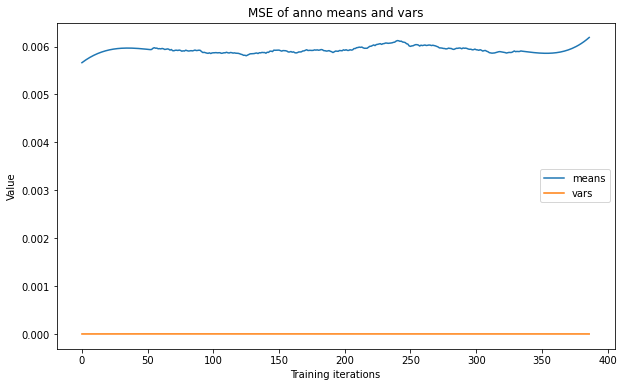

In [42]:
plt.figure(figsize=(10,6))
plt.title('MSE of anno means and vars')
plt.xlabel('Training iterations')
plt.ylabel('Value')
smoothed_anno_mse_means = signal.savgol_filter(anno_mse_means,101,3)
smoothed_anno_mse_vars = signal.savgol_filter(anno_mse_vars,101,3)
plt.plot(smoothed_anno_mse_means)
plt.plot(smoothed_anno_mse_vars)
plt.legend(['means', 'vars'])
plt.show()

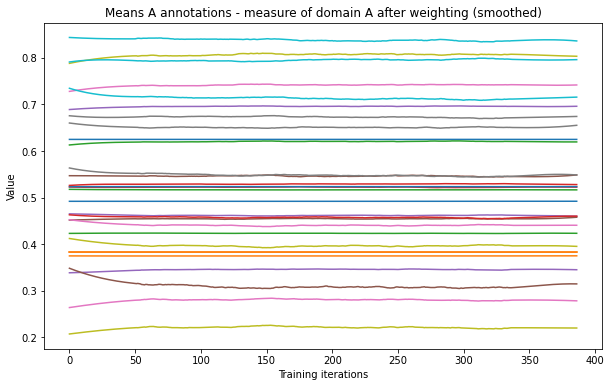

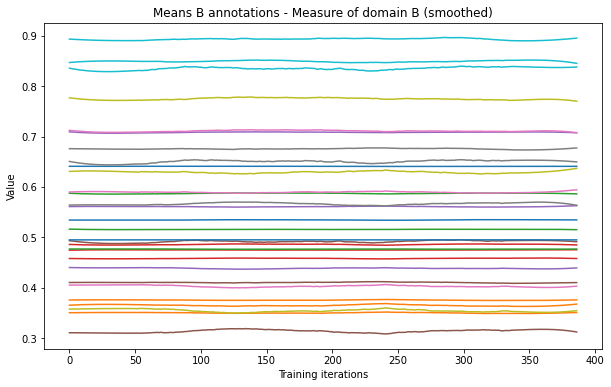

In [43]:
plt.figure(figsize=(10,6))
plt.title('Means A annotations - measure of domain A after weighting (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
# plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lmin = signal.savgol_filter(anno_means_A,101,3,axis=0)
plt.plot(smoothed_Lmin)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

plt.figure(figsize=(10,6))
plt.title('Means B annotations - Measure of domain B (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
# plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lplus = signal.savgol_filter(anno_means_B,101,3,axis=0)
plt.plot(smoothed_Lplus)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

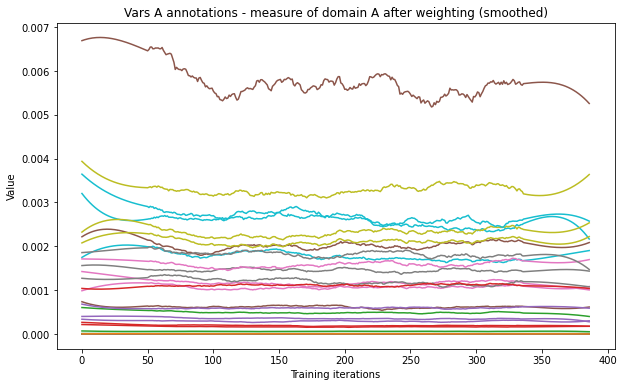

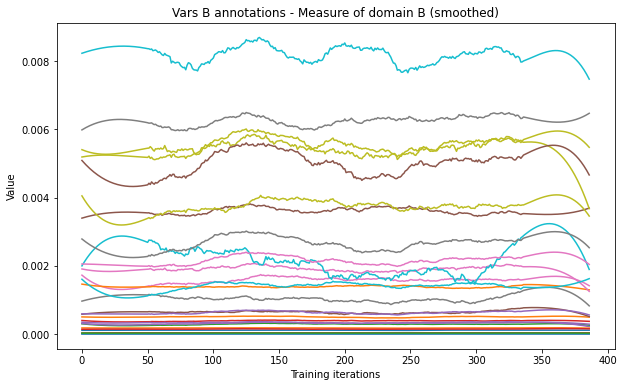

In [44]:
plt.figure(figsize=(10,6))
plt.title('Vars A annotations - measure of domain A after weighting (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
# plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lmin = signal.savgol_filter(anno_vars_A,101,3,axis=0)
plt.plot(smoothed_Lmin)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

plt.figure(figsize=(10,6))
plt.title('Vars B annotations - Measure of domain B (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
# plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lplus = signal.savgol_filter(anno_vars_B,101,3,axis=0)
plt.plot(smoothed_Lplus)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

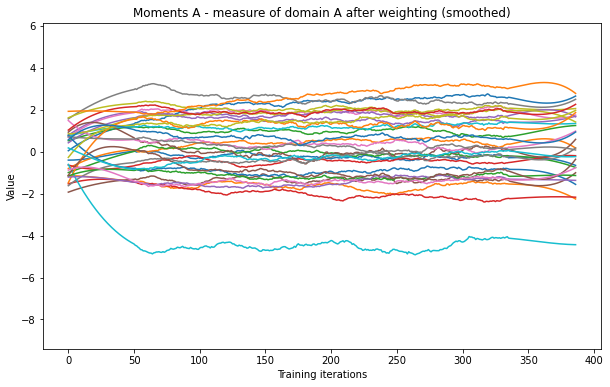

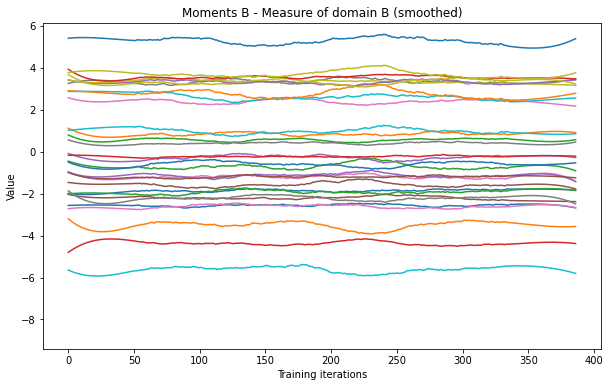

In [45]:
plt.figure(figsize=(10,6))
plt.title('Moments A - measure of domain A after weighting (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lmin = signal.savgol_filter(moments_A,101,3,axis=0)
plt.plot(smoothed_Lmin)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

plt.figure(figsize=(10,6))
plt.title('Moments B - Measure of domain B (smoothed)')
plt.xlabel('Training iterations')
plt.ylabel('Value')
plt.ylim(ymax = moments_A.max(), ymin = moments_A.min())
smoothed_Lplus = signal.savgol_filter(moments_B,101,3,axis=0)
plt.plot(smoothed_Lplus)
# plt.legend(np.arange(len(moments_A[0])))
plt.show()

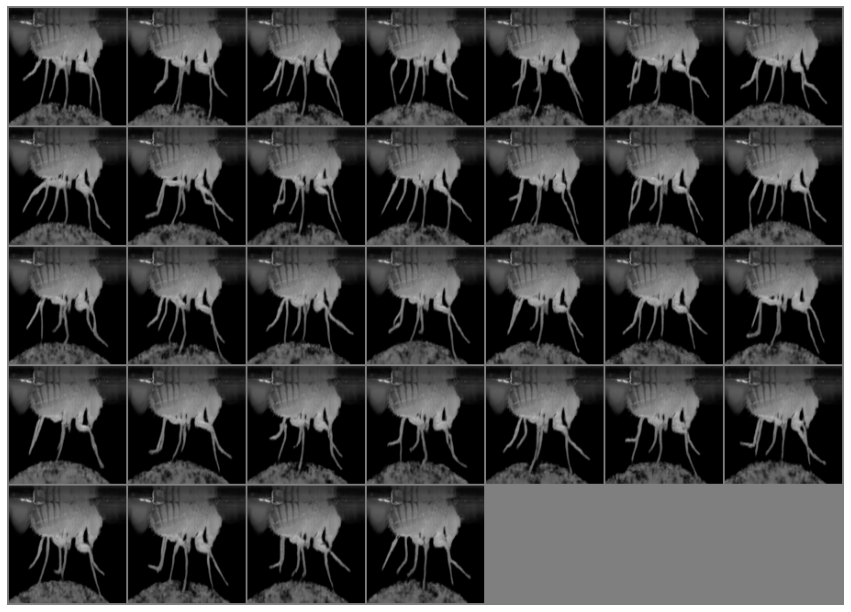

0 1.199113130569458
1 1.3347141742706299
2 1.653937816619873
3 1.027801275253296
4 0.16569127142429352
5 0.47683146595954895
6 0.4200570285320282
7 0.7383922338485718
8 2.36747145652771
9 0.6301154494285583
10 1.077235460281372
11 1.6243181228637695
12 1.075748324394226
13 0.24985766410827637
14 0.20724356174468994
15 0.3949972093105316
16 0.07243815809488297
17 0.9964848160743713
18 0.14463642239570618
19 0.6724388599395752
20 1.3353476524353027
21 0.1394025832414627
22 3.284994125366211
23 0.054512836039066315
24 1.8707987070083618
25 0.0986265316605568
26 0.39789217710494995
27 2.439210891723633
28 0.059422798454761505
29 3.9659314155578613
30 0.21193766593933105
31 1.6123989820480347


In [47]:
# These are generated images
weights = distribution_network(img_A)[0]
weights *= len(weights)

visualize_grid(make_grid(img_A.cpu(), nrow=7))

for i, weight in enumerate(weights):
  print(i, weight.item())

## Save/load distribution weights

In [14]:
# torch.save(distribution_network.state_dict(), '/content/drive/MyDrive/distributionnet_vaeA')

In [15]:
# # Load model
distribution_network = DistributionNet().cuda()
distribution_network.load_state_dict(torch.load('/content/drive/MyDrive/distributionnet_vaeA'))
distribution_network.eval()

DistributionNet(
  (softmax): Softmax(dim=0)
  (conv1): Conv2d(3, 10, kernel_size=(7, 7), stride=(1, 1))
  (conv2): Conv2d(10, 20, kernel_size=(5, 5), stride=(1, 1))
  (conv3): Conv2d(20, 40, kernel_size=(5, 5), stride=(1, 1))
  (fc1): Linear(in_features=5760, out_features=40, bias=True)
  (fc2): Linear(in_features=40, out_features=1, bias=True)
)

## More results

In [41]:
dataset = FlyDataset(annotations=True)

batch_size = 32
dataloader = DataLoader(dataset, batch_size, shuffle=True)

z_As = ()
z_Bs = ()

w_As = ()

annos_A = ()
annos_B = ()

for i, dataexample in enumerate(dataloader):
  img_A = dataexample['A'].cuda()
  img_B = dataexample['B'].cuda()

  anno_A = dataexample['A_anno'][:, :15].view(-1,30)
  anno_B = dataexample['B_anno'].view(-1,30)

  # # The embeddings
  _, z_A = ae(img_A)
  _, z_B = ae(img_B)

  # # The weighting process
  w_A = distribution_network(img_A)[0]
  w_B = 1/len(img_B)

  annos_A += (anno_A,)
  annos_B += (anno_B,)

  z_As += (z_A.detach().cpu(), )
  z_Bs += (z_B.detach().cpu(), )

  w_As += (w_A.detach().cpu(), )
  if i > 11:
    break # otherwise cuda out of memory

z_As = torch.cat(z_As)
z_Bs = torch.cat(z_Bs)
w_As = torch.cat(w_As)

annos_A = torch.cat(annos_A)
annos_B = torch.cat(annos_B)

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1628: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


In [61]:
pca_anno = PCA(n_components=2)
# pca_anno = pca.fit_transform((torch.cat((anno_A, anno_B))))
pca_anno_A = pca_anno.fit_transform(annos_A)
# pca_anno = pca.fit_transform(anno_B)

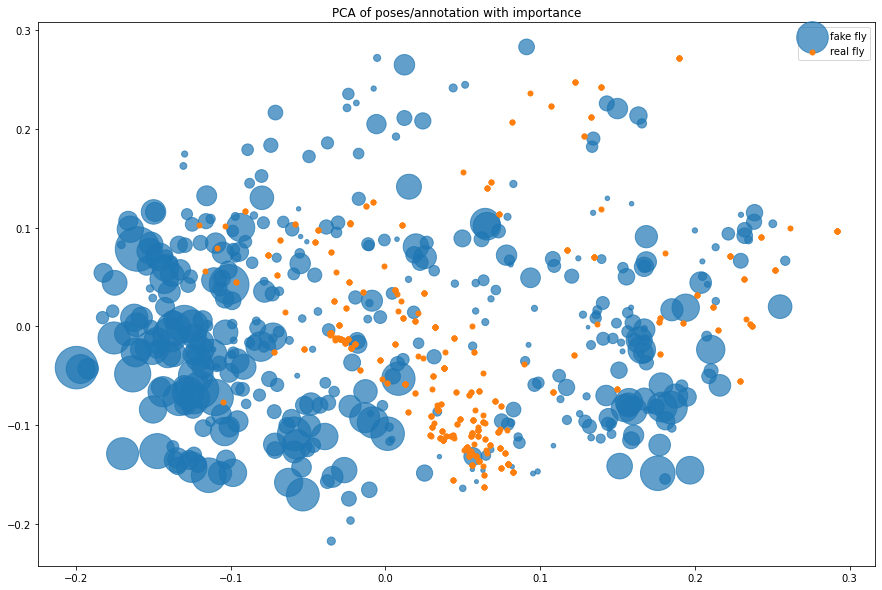

In [62]:
pca_anno_AB = pca.transform(torch.cat((annos_A, annos_B)))

scale = 25
plt.figure(figsize=(15,10))
plt.title('PCA of poses/annotation with importance')
plt.scatter(pca_anno_AB[:len(annos_A), 0], pca_anno_AB[:len(annos_A), 1], scale*(w_As*len(w_As)), alpha=0.7)
plt.scatter(pca_anno_AB[len(annos_A):, 0], pca_anno_AB[len(annos_A):, 1], scale)
plt.legend(['fake fly', 'real fly'])
plt.show()

In [65]:
targets = []

for weight in np.arange(-0.3, 0.3, 0.1):
  pose_components = weight*pca_anno.components_[0] + pca_anno.mean_
  targets += [np.array(draw_skeleton(transforms.ToPILImage()((img_A[0] + 1) / 2).convert("RGB"), pose_components.reshape(15,2)*128))]

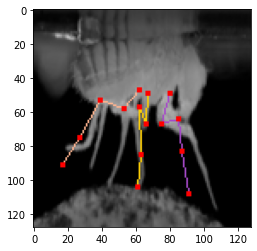

In [69]:
#%%capture
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure()
ax = fig.add_subplot(1,1,1)
ims = []
for i in range(len(targets)):
    im1=ax.imshow(targets[i],cmap='gray',animated=True)
    ims.append([im1])
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [70]:
pca_latent = PCA(n_components=2)
pca_latent.fit_transform(torch.cat((z_As, z_Bs)))
# pca.fit_transform(z_As)

array([[  2.21549986, -11.42510786],
       [  4.94678179,   8.63183216],
       [  8.13267723,  -3.02913128],
       ...,
       [-11.1979628 ,  -6.84348782],
       [-11.55224977,  -7.40545466],
       [ -5.84228546,  -9.89325119]])

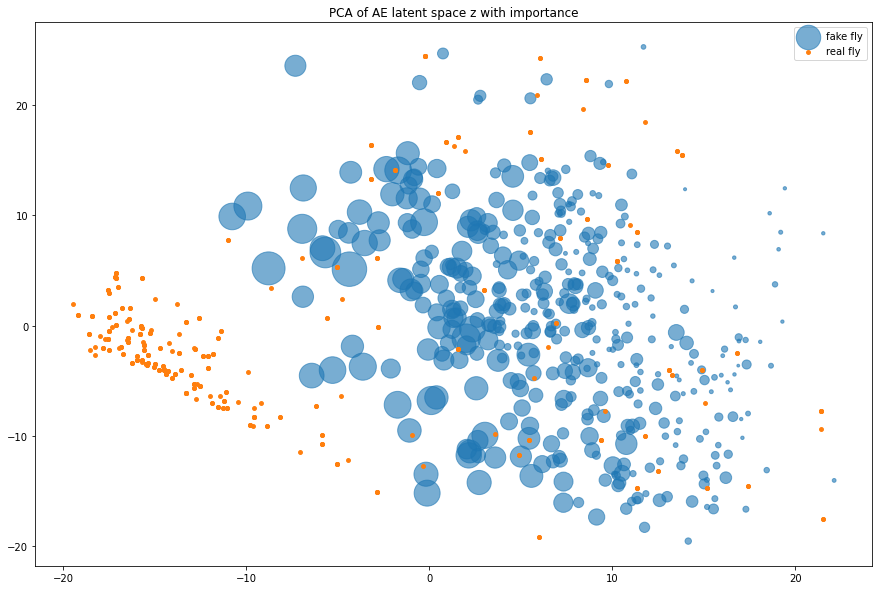

In [72]:
pca_z = pca_latent.transform(torch.cat((z_As, z_Bs)))

scale = 15
plt.figure(figsize=(15,10))
plt.title('PCA of AE latent space z with importance')
plt.scatter(pca_z[:len(z_As), 0], pca_z[:len(z_As), 1], scale*(w_As*len(w_As)), alpha=0.6)
plt.scatter(pca_z[len(z_As):, 0], pca_z[len(z_As):, 1], scale)
plt.legend(['fake fly', 'real fly'])
plt.show()

In [109]:
targets = []

for weight in np.arange(-25, 25, 0.5):
  latent_components = weight*pca_latent.components_[1] + pca_latent.mean_
  targets += [(ae.decode(torch.Tensor(latent_components).view(-1,32).cuda()).detach().cpu().squeeze(0).permute(1,2,0) + 1) / 2]

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1628: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


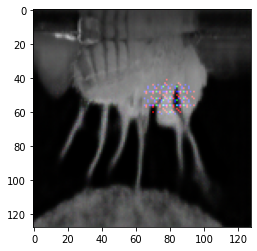

In [110]:
#%%capture
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure()
ax = fig.add_subplot(1,1,1)
ims = []
for i in range(len(targets)):
    im1=ax.imshow(targets[i],cmap='gray',animated=True)
    ims.append([im1])
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [111]:
writergif = animation.PillowWriter(fps=30)

ani.save('AE_z_secondcomponent.gif', writer=writergif)

In [52]:
# scale = 15
# plt.figure(figsize=(15,10))
# plt.title('PCA of poses/annotation with importance')
# plt.scatter(pca_anno[:len(anno_A), 0], pca_anno[:len(anno_A), 1], scale*(weights*len(weights)), alpha=0.7)
# plt.scatter(pca_anno[len(anno_A):, 0], pca_anno[len(anno_A):, 1], scale)
# plt.legend(['fake fly', 'real fly'])
# plt.show()

In [ ]:
# TODO: sort on component and visualize images
# Train AE on fake data only
# interpolation on AE latent space: look at similarity between PCA and AE latent space interpolations
# interpolation of AE reconstructed images 
# VAE with lower weight on prior
# Future work: generate realistic poses
# Filter out part of fake images